In [1]:
%load_ext autoreload
%autoreload 2

import pymc as pm
import seaborn as sns
import pandas as pd
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)
import numpy as np
import arviz as az
from matplotlib import pyplot as plt

import sys
sys.path.append('..')
from pfas_prep import PFAS
from PyPKMC import PyPKMC
import register_pfas_data as rpd

In [2]:
chemical = 'PFOA'
pfas_db = '../PFAS.db'
pfas_tmp = PFAS(pfas_db, pfas_file = '../auxiliary/pfas_master.csv')
Vdss_prior = {'mu': -1.5, 'sd': 1.5}
CLC_prior = {'mu': -2.89, 'sd': 2.68}
load_trace = False

# Rat fits

## Male

First import the data using the old PFAS class

In [3]:
%%time
pfas_male_data = pfas_tmp.get_processed_data(chemical=chemical, sex='Male', species='rat')
pfas_male_data.head()

Hero ID available:  [2919359 2990271 3749227 3749289 3858670 3859701 5916078 6302380]
dropping duplicated column
Hero ID used:  [2990271 3749289 3858670 3859701 5916078 6302380]
CPU times: user 3.01 s, sys: 9.97 ms, total: 3.02 s
Wall time: 3.07 s


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,time_course,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,2990271,53,-1,3,-1.0,NaN,0.280012,NaN,rat,wistar,48.63,umol/kg,5.0,minute,323.694091,78.136621,0,nmol/ml,iv,plasma,Male,DTXSID8031865,Figure 1,10.0,weeks,280.0,grams,3,Kudo,Perfluorooctanoic acid,PFOA,335-67-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-pentadecafluoroo...",DTXSID8031865,8,0,0,0,0.003472,20.136224,72.262436,0.280012,134.032012,32.354031,0.0,-1,0,0,0,0.237981,4.869761,0.241390,False,5.638393,2990271-20.14 mg/kg-iv
1,2990271,53,-1,3,-1.0,NaN,0.280012,NaN,rat,wistar,48.63,umol/kg,1.0,hour,230.212754,34.320202,0,nmol/ml,iv,plasma,Male,DTXSID8031865,Figure 1,10.0,weeks,280.0,grams,3,Kudo,Perfluorooctanoic acid,PFOA,335-67-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-pentadecafluoroo...",DTXSID8031865,8,0,0,0,0.041667,20.136224,72.300631,0.280149,95.324195,14.210966,0.0,-1,0,0,0,0.148262,4.546293,0.149080,False,5.638393,2990271-20.14 mg/kg-iv
2,2990271,53,-1,3,-1.0,NaN,0.280012,NaN,rat,wistar,48.63,umol/kg,6.0,hour,203.238224,33.950664,0,nmol/ml,iv,plasma,Male,DTXSID8031865,Figure 1,10.0,weeks,280.0,grams,3,Kudo,Perfluorooctanoic acid,PFOA,335-67-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-pentadecafluoroo...",DTXSID8031865,8,0,0,0,0.250000,20.136224,72.508964,0.280896,84.154851,14.057952,0.0,-1,0,0,0,0.165901,4.418897,0.167049,False,5.638393,2990271-20.14 mg/kg-iv
3,2990271,53,-1,3,-1.0,NaN,0.280012,NaN,rat,wistar,48.63,umol/kg,12.0,hour,144.391550,24.130868,0,nmol/ml,iv,plasma,Male,DTXSID8031865,Figure 1,10.0,weeks,280.0,grams,3,Kudo,Perfluorooctanoic acid,PFOA,335-67-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-pentadecafluoroo...",DTXSID8031865,8,0,0,0,0.500000,20.136224,72.758964,0.281793,59.788209,9.991868,0.0,-1,0,0,0,0.165971,4.077035,0.167121,False,5.638393,2990271-20.14 mg/kg-iv
4,2990271,53,-1,3,-1.0,NaN,0.280012,NaN,rat,wistar,48.63,umol/kg,1.0,day,99.264156,27.837423,0,nmol/ml,iv,plasma,Male,DTXSID8031865,Figure 1,10.0,weeks,280.0,grams,3,Kudo,Perfluorooctanoic acid,PFOA,335-67-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-pentadecafluoroo...",DTXSID8031865,8,0,0,0,1.000000,20.136224,73.258964,0.283586,41.102309,11.526642,0.0,-1,0,0,0,0.275147,3.678211,0.280438,False,5.638393,2990271-20.14 mg/kg-iv


### Run the models

#### 1-Compartment model

In [4]:
pfas_male_1cmpt = PyPKMC(pfas_male_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_1cmpt.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                   load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFOA_Male_rat_1cmpt
hierarchical model, 1-compartment


Sampling: [conc_indiv, conc_summary, fa, kappaMinusTwo, lnCLC_offset, lnVd_offset, lnk_abs_offset, mu_fa, mu_lnCLC, mu_lnVd, mu_lnk_abs, sigma, sigma_lnCLC, sigma_lnVd, sigma_lnk_abs]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

2024-08-14 14:24:56.411909: E external/xla/xla/service/slow_operation_alarm.cc:65] Constant folding an instruction is taking > 1s:

  %reduce = f64[4,5000,860]{2,1,0} reduce(f64[4,5000,1,860]{3,2,1,0} %broadcast.34, f64[] %constant.39), dimensions={2}, to_apply=%region_1.98, metadata={op_name="jit(process_fn)/jit(main)/reduce_prod[axes=(2,)]" source_file="/data/tzurlind/tmp/tmprejcwqxu" source_line=59}

This isn't necessarily a bug; constant-folding is inherently a trade-off between compilation time and speed at runtime. XLA has some guards that attempt to keep constant folding from taking too long, but fundamentally you'll always be able to come up with an input program that takes a long time.

If you'd like to file a bug, run with envvar XLA_FLAGS=--xla_dump_to=/tmp/foo and attach the results.
2024-08-14 14:25:41.773033: E external/xla/xla/service/slow_operation_alarm.cc:133] The operation took 46.361240146s
Constant folding an instruction is taking > 1s:

  %reduce = f64[4,5000,860]

Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (45), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


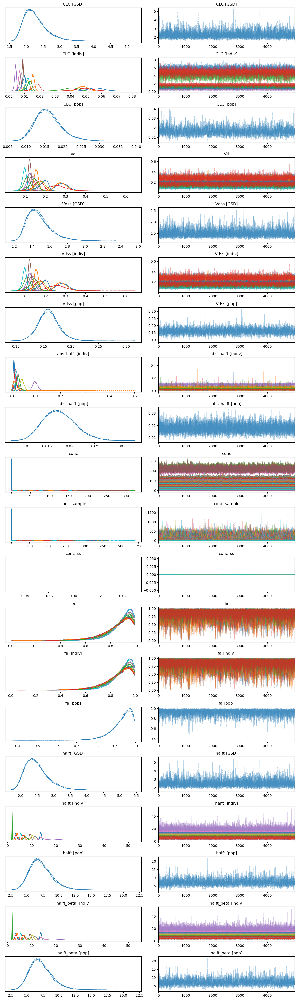

In [5]:
with pfas_male_1cmpt.model:
    az.plot_trace(pfas_male_1cmpt._trace)
    plt.tight_layout()

conc_indiv
conc_summary


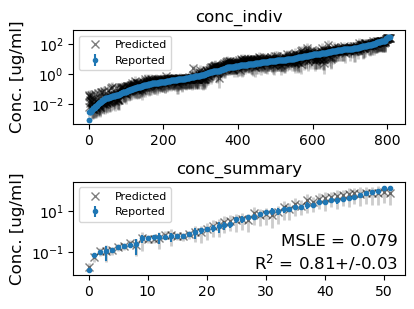

In [6]:
pfas_male_1cmpt.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [91]:
pfas_male_2cmpt = PyPKMC(pfas_male_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx', Rkcd_SD_prior = 1,
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_2cmpt.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro',
                   load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFOA_Male_rat_2cmpt
hierarchical model, 2-compartment


Sampling: [conc_indiv, conc_summary, fa, kappaMinusTwo, lnCLC_offset, lnR_offset, lnVdss_offset, lnk_abs_offset, lnk_cd_offset, mu_fa, mu_lnCLC, mu_lnR, mu_lnVdss, mu_lnk_abs, mu_lnk_cd, sigma, sigma_lnCLC, sigma_lnR, sigma_lnVdss, sigma_lnk_abs, sigma_lnk_cd]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (83), generating only 20 plots
  warnings.warn(


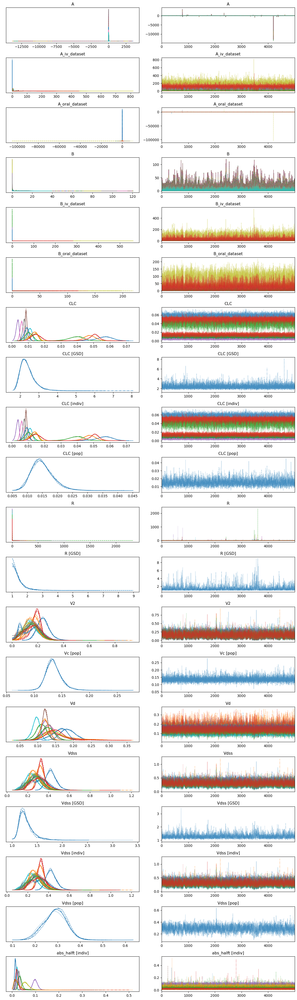

In [92]:
with pfas_male_2cmpt.model:
    az.plot_trace(pfas_male_2cmpt._trace)
    plt.tight_layout()

In [93]:
summary = az.summary(pfas_male_2cmpt._trace)

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/diagnostics.py:592: RuntimeWarning: invalid value encountered in scalar divide
  (between_chain_variance / within_chain_variance + num_samples - 1) / (num_samples)


In [94]:
pfas_male_2cmpt.bayes_r2

r2        0.829196
r2_std    0.026380
dtype: float64

conc_indiv
conc_summary


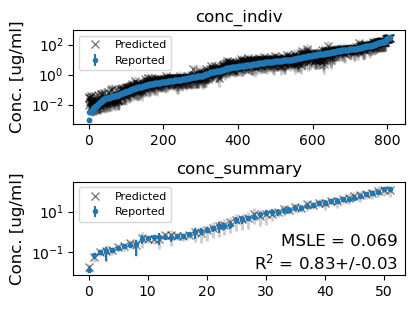

In [95]:
pfas_male_2cmpt.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-1384.802509,72.303573,0.000000,0.919601,88.135284,0.000000,True,log
1_compartment,1,-1431.105254,58.494912,46.302745,0.080399,91.004168,11.090636,True,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

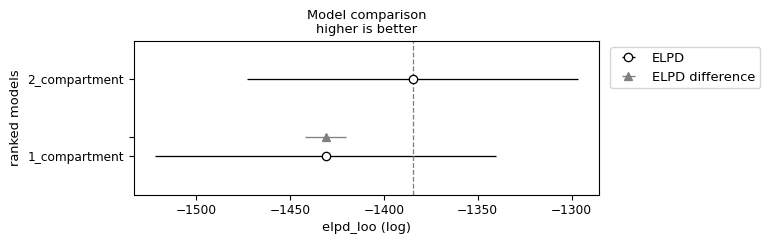

In [96]:
pfas_male_compare = az.compare({"1_compartment": pfas_male_1cmpt._trace, "2_compartment": pfas_male_2cmpt._trace},
                           var_name="combined",ic='loo')
display(pfas_male_compare)
az.plot_compare(pfas_male_compare, insample_dev=False)

#### Define winning model

In [97]:
pfas_male = pfas_male_2cmpt
print(pfas_male.N_divergences)
print(f'Pass all metrics = {pfas_male.pass_all_metrics}')

0
Pass all metrics = True


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


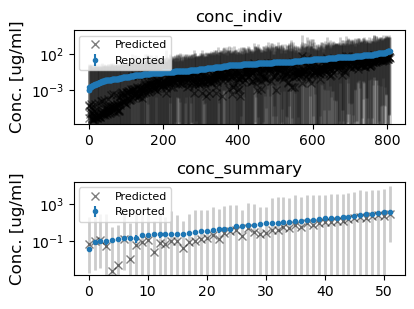

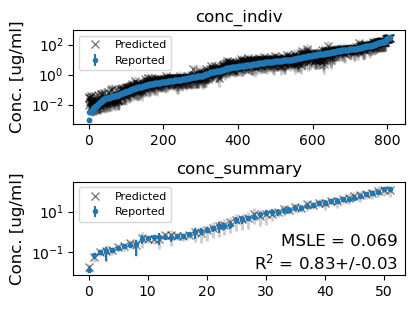

In [98]:
pfas_male.plot_data_ppc(group='prior', savefig=True)
pfas_male.plot_data_ppc(group='posterior', savefig=True)

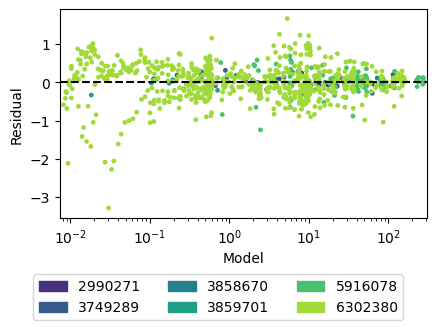

In [99]:
# r = log(obs) - log(pred)
pfas_male.plot_residuals() 

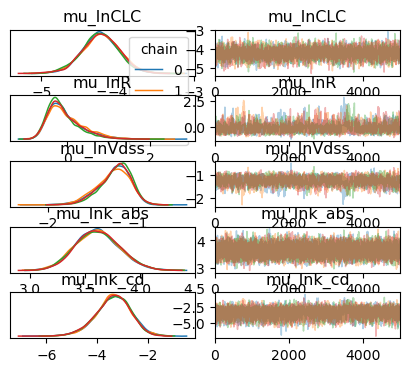

In [100]:
trace_model = pfas_male
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    fig = plt.gcf()
    ratio = fig.get_figwidth()/fig.get_figheight()
    fig.set_size_inches(4, 4/ratio)
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/rat/PFOA/PFOA_Male_rat_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


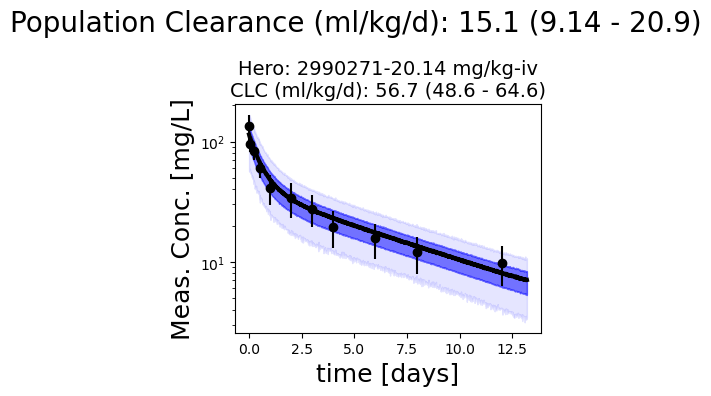

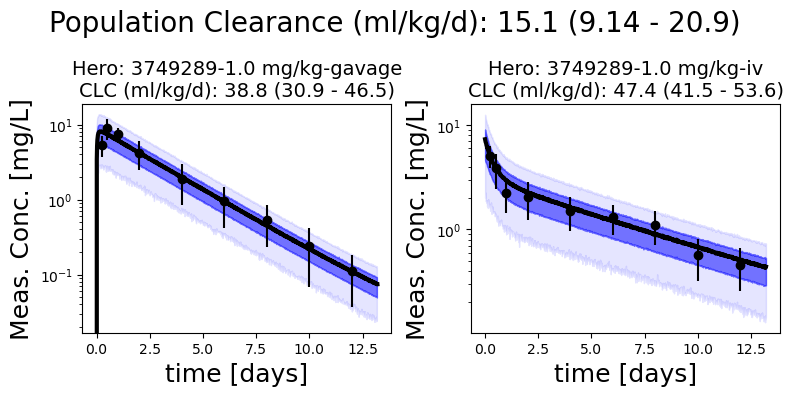

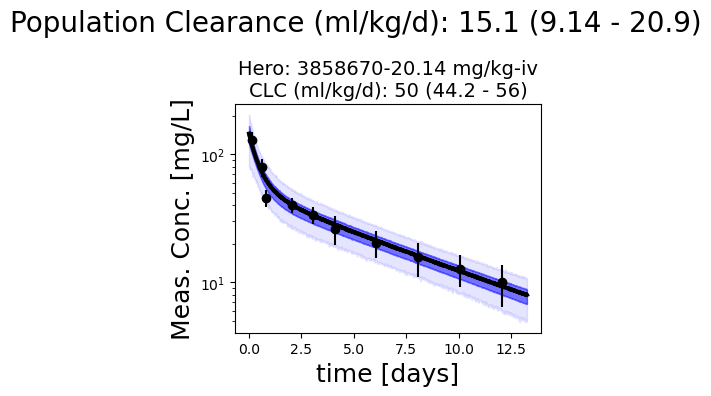

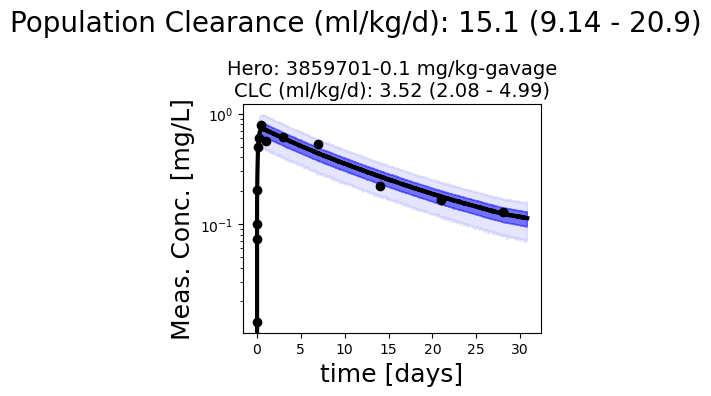

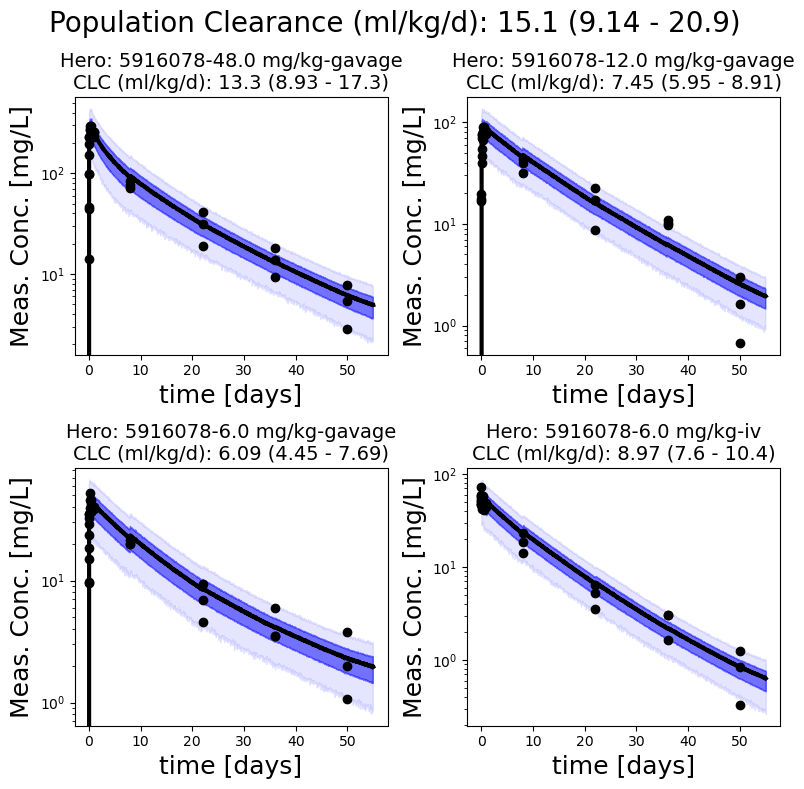

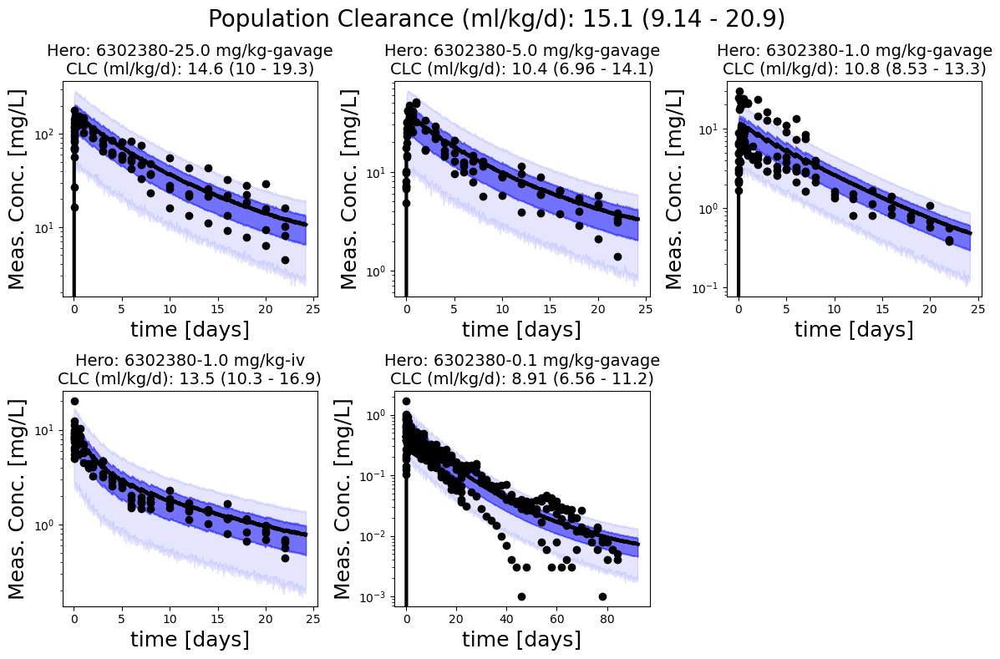

In [101]:
pfas_male.plot_all_studies()

### PK stats

In [102]:
pfas_male.get_pk_stats()

,mean,sd,hdi_5%,hdi_95%
CLC [pop],0.01507,0.00374,0.00914,0.02088
Vc [pop],0.13556,0.01466,0.11311,0.15863
Vdss [pop],0.28945,0.04951,0.20665,0.36786
abs_halft [pop],0.01902,0.00382,0.01290,0.02523
fa [pop],0.92846,0.05461,0.85416,0.99917
halft [pop],14.20016,4.59277,7.15971,21.10304
halft_alpha [pop],4.36786,1.36218,2.25794,6.68581
halft_beta [pop],40.79251,34.30692,6.89947,72.95333


## Female

Skip Ohmori (3858670) for PFOA in female rats because data only taken out to 6 hours

In [19]:
%%time
pfas_female_data = pfas_tmp.get_processed_data(chemical=chemical, sex='Female', species='rat')
pfas_female_data = pfas_female_data[~pfas_female_data.hero_id.isin([3858670])] # Remove 3858670
pfas_female_data.head()

Hero ID available:  [2919359 2990271 3749227 3749289 3858670 3859701 5916078 6302380]
dropping duplicated column
Hero ID used:  [2990271 3749289 3858670 5916078 6302380]
CPU times: user 1.65 s, sys: 1.79 ms, total: 1.66 s
Wall time: 1.66 s


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,time_course,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,2990271,54,-1,3,-1.0,NaN,0.213002,NaN,rat,wistar,48.63,umol/kg,5.0,minute,304.271626,50.872236,0,nmol/ml,iv,plasma,Female,DTXSID8031865,Figure 1,10.0,weeks,213.0,grams,3,Kudo,Perfluorooctanoic acid,PFOA,335-67-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-pentadecafluoroo...",DTXSID8031865,6,0,0,0,0.003472,20.136224,111.128472,0.213002,125.989752,21.064667,0.0,-1,0,0,1,0.166042,4.822416,0.167193,False,4.289064,2990271-20.14 mg/kg-iv
1,2990271,54,-1,3,-1.0,NaN,0.213002,NaN,rat,wistar,48.63,umol/kg,1.0,hour,132.071352,33.286586,0,nmol/ml,iv,plasma,Female,DTXSID8031865,Figure 1,10.0,weeks,213.0,grams,3,Kudo,Perfluorooctanoic acid,PFOA,335-67-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-pentadecafluoroo...",DTXSID8031865,6,0,0,0,0.041667,20.136224,111.166667,0.213029,54.686785,13.782977,0.0,-1,0,0,1,0.248165,3.970829,0.252035,False,4.289064,2990271-20.14 mg/kg-iv
2,2990271,54,-1,3,-1.0,NaN,0.213002,NaN,rat,wistar,48.63,umol/kg,6.0,hour,23.016989,21.717955,0,nmol/ml,iv,plasma,Female,DTXSID8031865,Figure 1,10.0,weeks,213.0,grams,3,Kudo,Perfluorooctanoic acid,PFOA,335-67-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-pentadecafluoroo...",DTXSID8031865,6,0,0,0,0.250000,20.136224,111.375000,0.213171,9.530645,8.992754,0.0,-1,0,0,1,0.797960,1.936142,0.943562,False,4.289064,2990271-20.14 mg/kg-iv
3,2990271,54,-1,3,-1.0,NaN,0.213002,NaN,rat,wistar,48.63,umol/kg,12.0,hour,3.599369,4.195932,0,nmol/ml,iv,plasma,Female,DTXSID8031865,Figure 1,10.0,weeks,213.0,grams,3,Kudo,Perfluorooctanoic acid,PFOA,335-67-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-pentadecafluoroo...",DTXSID8031865,6,0,0,0,0.500000,20.136224,111.625000,0.213343,1.490391,0.000000,0.0,-1,0,0,1,0.000000,0.399038,0.000000,False,4.289064,2990271-20.14 mg/kg-iv
4,2990271,54,-1,3,-1.0,NaN,0.213002,NaN,rat,wistar,48.63,umol/kg,1.0,day,0.528698,0.747060,0,nmol/ml,iv,plasma,Female,DTXSID8031865,Figure 1,10.0,weeks,213.0,grams,3,Kudo,Perfluorooctanoic acid,PFOA,335-67-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-pentadecafluoroo...",DTXSID8031865,6,0,0,0,1.000000,20.136224,112.125000,0.213668,0.218918,0.000000,0.0,-1,0,0,1,0.000000,-1.519058,0.000000,False,4.289064,2990271-20.14 mg/kg-iv


### Run the models

#### 1-Compartment model

In [20]:
pfas_female_1cmpt = PyPKMC(pfas_female_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_1cmpt.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro', random_seed=98756,
                   load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFOA_Female_rat_1cmpt
hierarchical model, 1-compartment


Sampling: [conc_indiv, conc_summary, fa, kappaMinusTwo, lnCLC_offset, lnVd_offset, lnk_abs_offset, mu_fa, mu_lnCLC, mu_lnVd, mu_lnk_abs, sigma, sigma_lnCLC, sigma_lnVd, sigma_lnk_abs]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (45), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


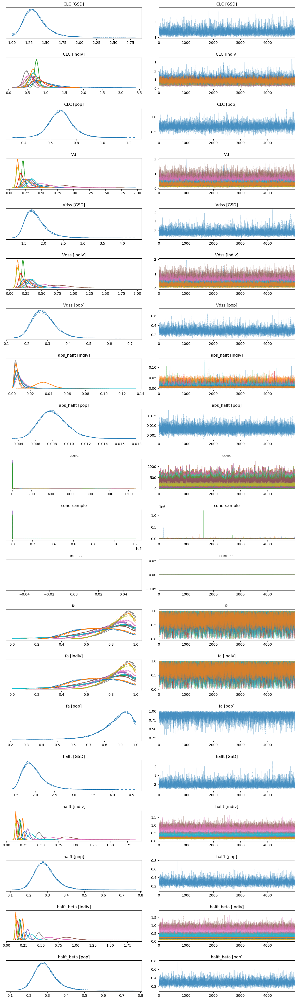

In [21]:
with pfas_female_1cmpt.model:
    az.plot_trace(pfas_female_1cmpt._trace)
    plt.tight_layout()

conc_indiv
conc_summary


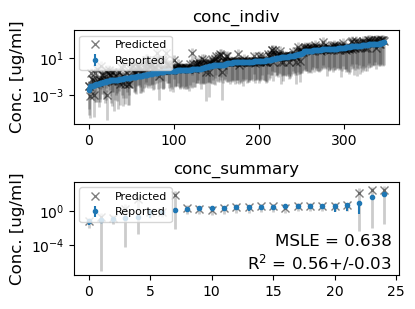

In [22]:
pfas_female_1cmpt.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [23]:
# Change  SD2 --> 0.1
pfas_female_2cmpt = PyPKMC(pfas_female_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_2cmpt.sample(model_type='2-compartment', target_accept=0.999, nuts_sampler='numpyro',
                   load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)
                    

PFOA_Female_rat_2cmpt
hierarchical model, 2-compartment


Sampling: [conc_indiv, conc_summary, fa, kappaMinusTwo, lnCLC_offset, lnR_offset, lnVdss_offset, lnk_abs_offset, lnk_cd_offset, mu_fa, mu_lnCLC, mu_lnR, mu_lnVdss, mu_lnk_abs, mu_lnk_cd, sigma, sigma_lnCLC, sigma_lnR, sigma_lnVdss, sigma_lnk_abs, sigma_lnk_cd]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


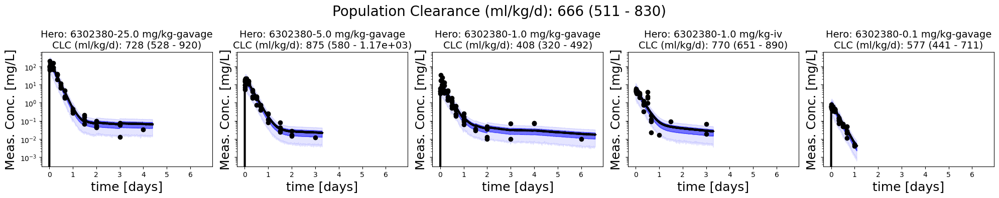

In [24]:
#sns.set_theme()
_ = ax = pfas_female_2cmpt._study_ppc(6302380, constant_ax=True, flat_grid=True)

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (83), generating only 20 plots
  warnings.warn(


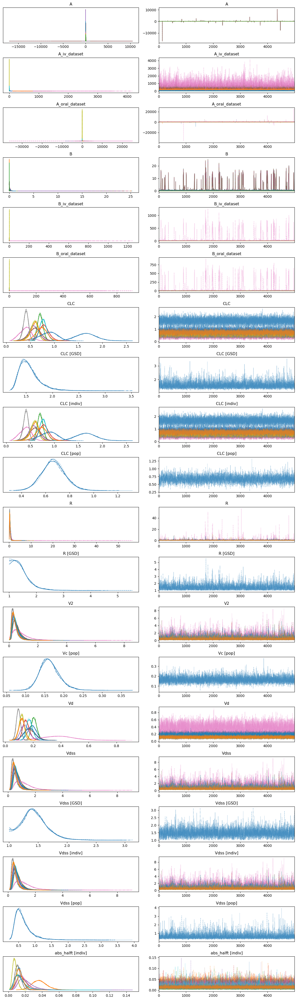

In [25]:
with pfas_female_2cmpt.model:
    az.plot_trace(pfas_female_2cmpt._trace)
    plt.tight_layout()

conc_indiv
conc_summary


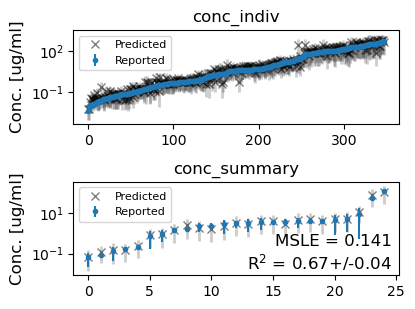

In [26]:
pfas_female_2cmpt.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-880.699209,50.335602,0.000000,0.971683,69.815711,0.000000,True,log
1_compartment,1,-1149.701036,43.948601,269.001826,0.028317,64.866856,26.349618,True,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

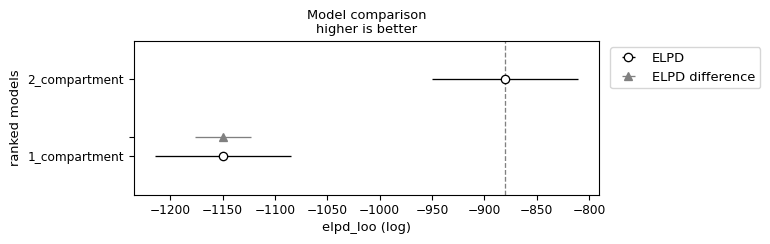

In [27]:
pfas_female_compare = az.compare({"1_compartment": pfas_female_1cmpt._trace, "2_compartment": pfas_female_2cmpt._trace},
                           var_name="combined",ic='loo')
display(pfas_female_compare)
az.plot_compare(pfas_female_compare, insample_dev=False)

#### Define winning model

In [103]:
pfas_female = pfas_female_2cmpt
print(pfas_female.N_divergences)
print(f'Pass all metrics = {pfas_female_2cmpt.pass_all_metrics}')

0
Pass all metrics = True


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


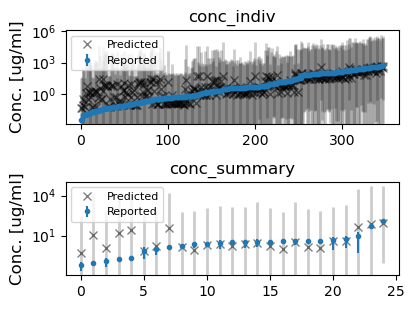

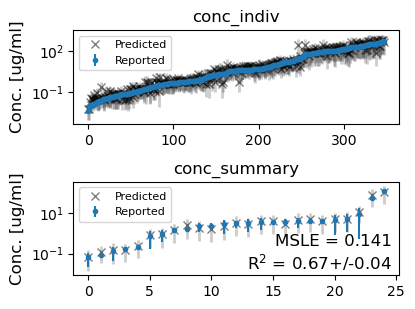

In [29]:
pfas_female.plot_data_ppc(group='prior', savefig=True)
pfas_female.plot_data_ppc(group='posterior', savefig=True)

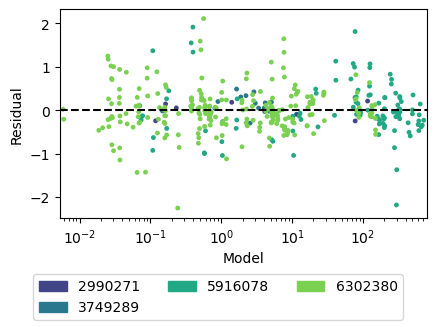

In [30]:
pfas_female.plot_residuals() 

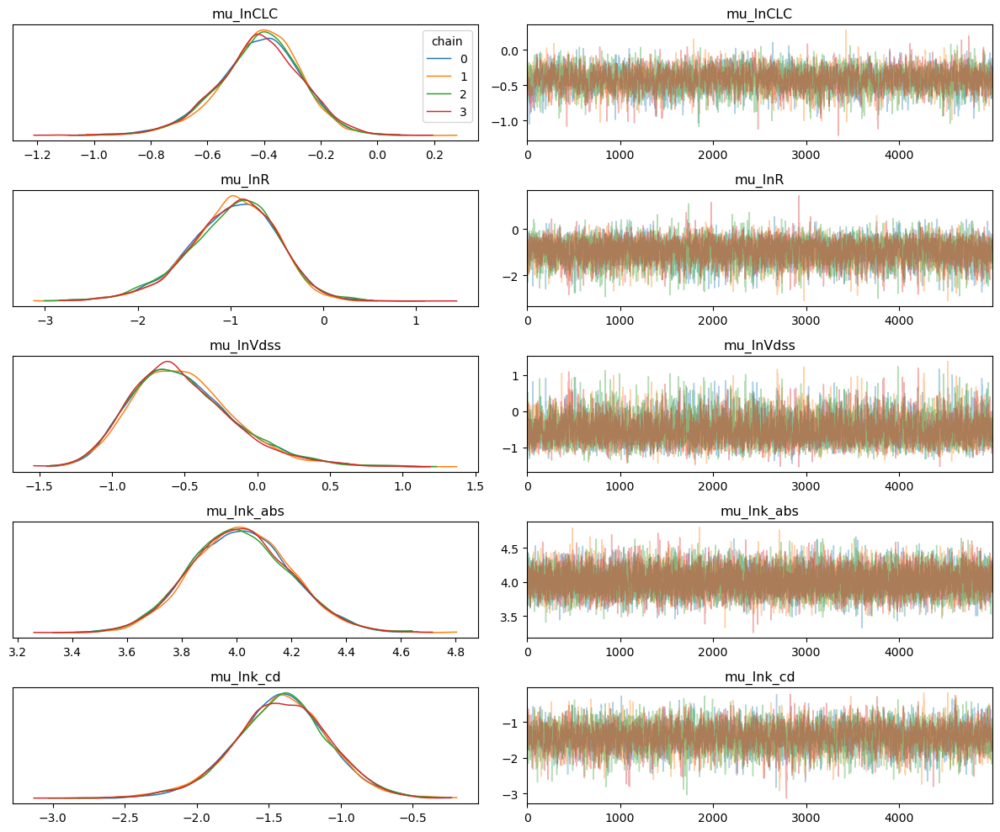

In [31]:
trace_model = pfas_female
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/rat/PFOA/PFOA_Female_rat_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


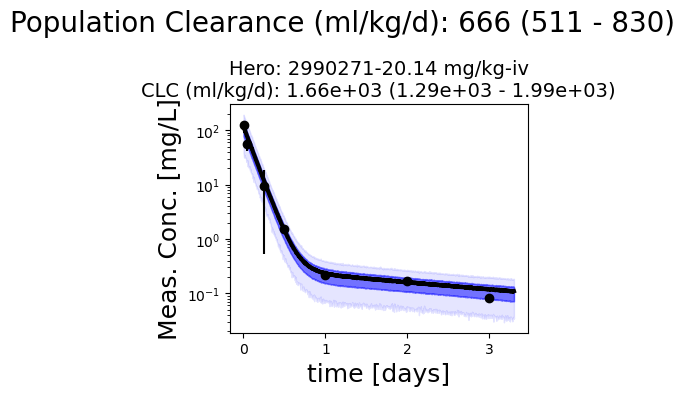

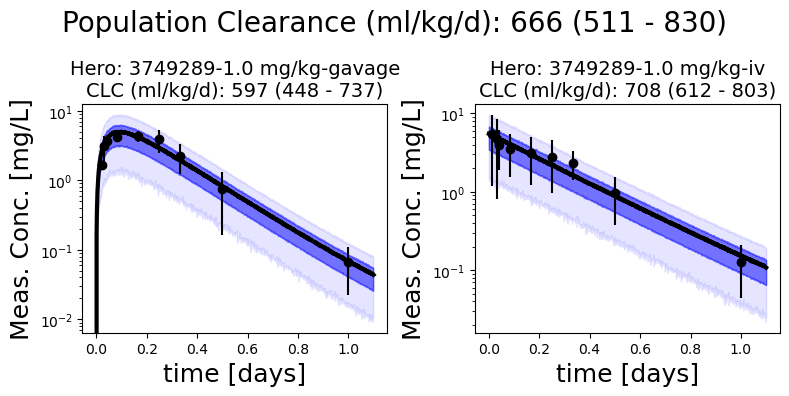

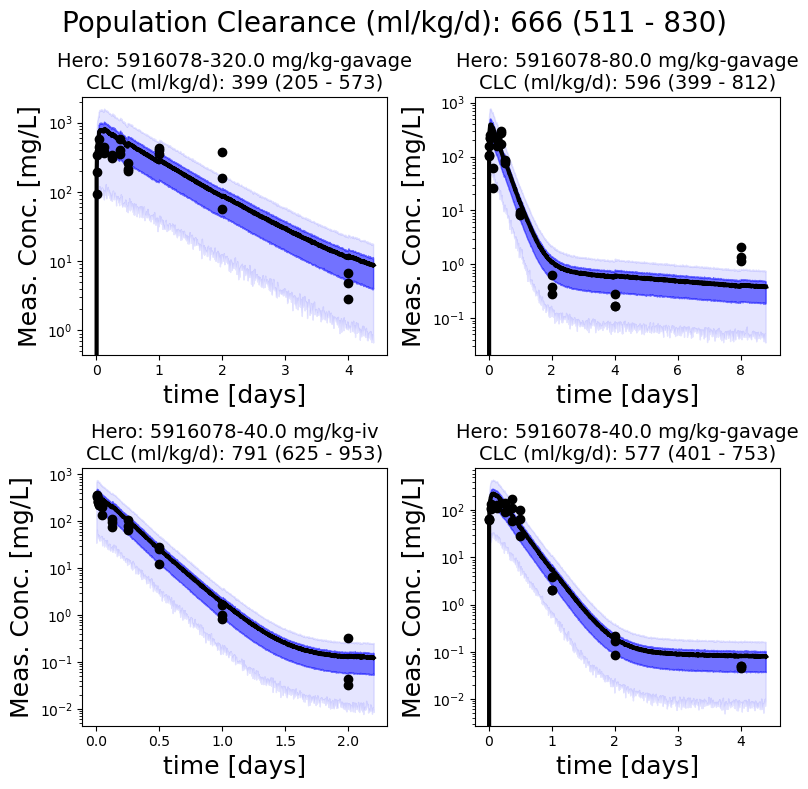

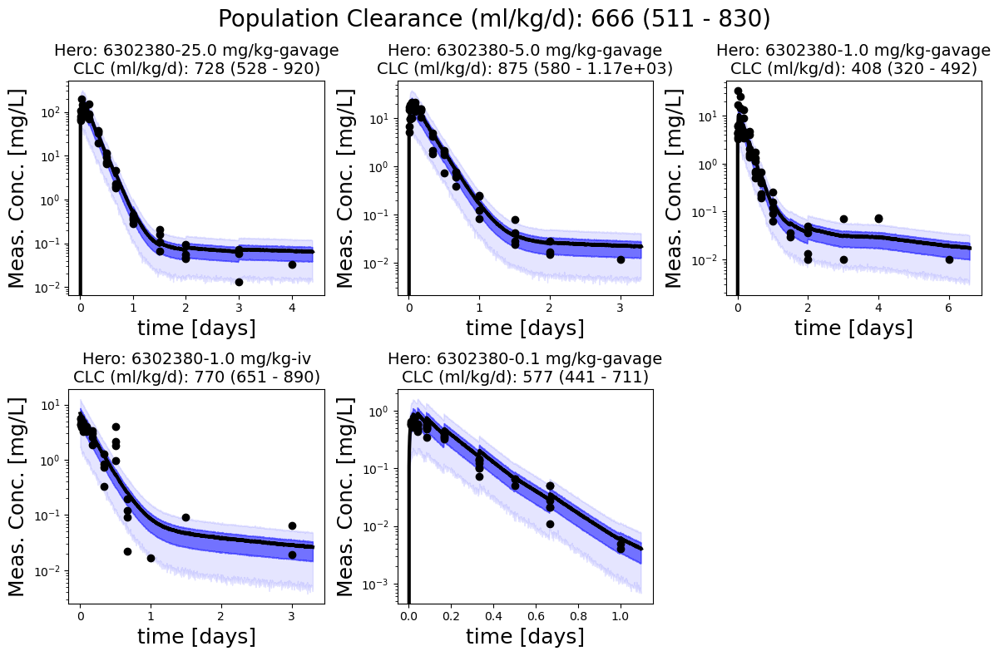

In [32]:
pfas_female.plot_all_studies()

### PK stats

In [33]:
pfas_female.get_pk_stats()

,mean,sd,hdi_5%,hdi_95%
CLC [pop],0.66628,0.09788,0.51060,0.82974
Vc [pop],0.16322,0.02631,0.11894,0.20281
Vdss [pop],0.64862,0.28629,0.30306,0.99927
abs_halft [pop],0.01272,0.00230,0.00899,0.01641
fa [pop],0.89398,0.08314,0.78412,0.99940
halft [pop],0.69046,0.33433,0.29602,1.09248
halft_alpha [pop],0.16167,0.02913,0.11344,0.20530
halft_beta [pop],8.82968,3.92115,3.50038,14.31049


# Mouse

## Male

In [34]:
%%time
pfas_male_data_mouse = pfas_tmp.get_processed_data(chemical=chemical, sex='Male', species='mouse')
pfas_male_data_mouse.head()

Hero ID available:  [2919359 2990271 3749227 3749289 3858670 3859701 5916078 6302380]
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No

,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,2919359,55,3249,1,-1.0,NaN,0.031,NaN,mouse,CD-1,1.0,mg/kg,4.0,hour,4080.0,0.0,0,ng/ml,gavage,serum,Male,DTXSID8031865,Supplementary Table 1 mg/kg Block 1,75.0,days,NaN,Not Reported,3,Lou,Perfluorooctanoic acid,PFOA,335-67-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-pentadecafluoroo...",DTXSID8031865,17,0,0,0,0.166667,1.0,0.031,4.08,0.0,0.0,-1,0,1,0,0.0,1.406097,0.0,True,0.031,2919359-1.0 mg/kg-gavage
1,2919359,55,3250,1,-1.0,NaN,0.031,NaN,mouse,CD-1,1.0,mg/kg,4.0,hour,4120.0,0.0,0,ng/ml,gavage,serum,Male,DTXSID8031865,Supplementary Table 1 mg/kg Block 1,75.0,days,NaN,Not Reported,3,Lou,Perfluorooctanoic acid,PFOA,335-67-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-pentadecafluoroo...",DTXSID8031865,17,0,0,0,0.166667,1.0,0.031,4.12,0.0,0.0,-1,0,1,0,0.0,1.415853,0.0,True,0.031,2919359-1.0 mg/kg-gavage
2,2919359,55,3251,1,-1.0,NaN,0.031,NaN,mouse,CD-1,1.0,mg/kg,4.0,hour,5350.0,0.0,0,ng/ml,gavage,serum,Male,DTXSID8031865,Supplementary Table 1 mg/kg Block 1,75.0,days,NaN,Not Reported,3,Lou,Perfluorooctanoic acid,PFOA,335-67-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-pentadecafluoroo...",DTXSID8031865,17,0,0,0,0.166667,1.0,0.031,5.35,0.0,0.0,-1,0,1,0,0.0,1.677097,0.0,True,0.031,2919359-1.0 mg/kg-gavage
3,2919359,55,3754,1,-1.0,NaN,0.031,NaN,mouse,CD-1,1.0,mg/kg,4.0,hour,3960.0,0.0,0,ng/ml,gavage,serum,Male,DTXSID8031865,Supplementary Table 1 mg/kg Block 2,75.0,days,NaN,Not Reported,3,Lou,Perfluorooctanoic acid,PFOA,335-67-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-pentadecafluoroo...",DTXSID8031865,17,0,0,0,0.166667,1.0,0.031,3.96,0.0,0.0,-1,0,1,0,0.0,1.376244,0.0,True,0.031,2919359-1.0 mg/kg-gavage
4,2919359,55,3755,1,-1.0,NaN,0.031,NaN,mouse,CD-1,1.0,mg/kg,4.0,hour,5650.0,0.0,0,ng/ml,gavage,serum,Male,DTXSID8031865,Supplementary Table 1 mg/kg Block 2,75.0,days,NaN,Not Reported,3,Lou,Perfluorooctanoic acid,PFOA,335-67-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-pentadecafluoroo...",DTXSID8031865,17,0,0,0,0.166667,1.0,0.031,5.65,0.0,0.0,-1,0,1,0,0.0,1.731656,0.0,True,0.031,2919359-1.0 mg/kg-gavage


### Run the models

#### 1-Compartment model

In [35]:
pfas_male_1cmpt_mouse = PyPKMC(pfas_male_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior, #pop_SD_prior=0.2
                              )
pfas_male_1cmpt_mouse.sample(model_type='1-compartment', target_accept=0.999, nuts_sampler='numpyro', #hierarchy='single',
                             load_trace=load_trace, tune=12000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFOA_Male_mouse_1cmpt
single level model, 1-compartment


Sampling: [conc_indiv, conc_summary, lnCLC, lnVd, lnk_abs, sigma]


  0%|          | 0/17000 [00:00<?, ?it/s]

  0%|          | 0/17000 [00:00<?, ?it/s]

  0%|          | 0/17000 [00:00<?, ?it/s]

  0%|          | 0/17000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


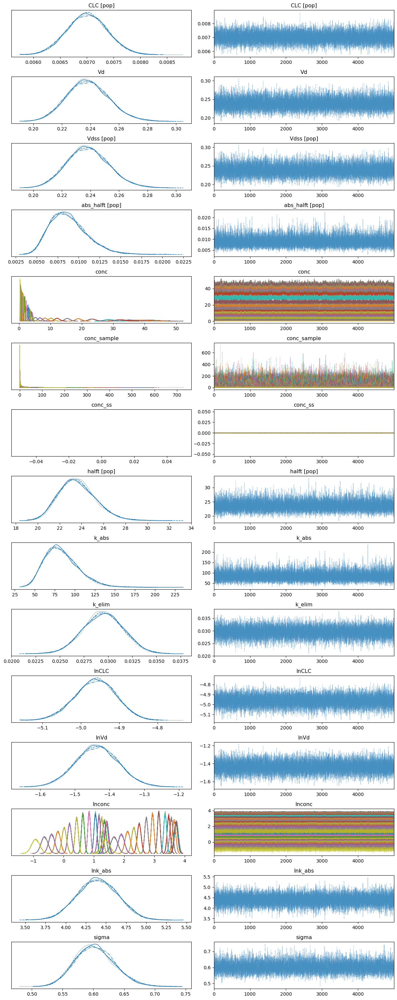

In [36]:
with pfas_male_1cmpt_mouse.model:
    az.plot_trace(pfas_male_1cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


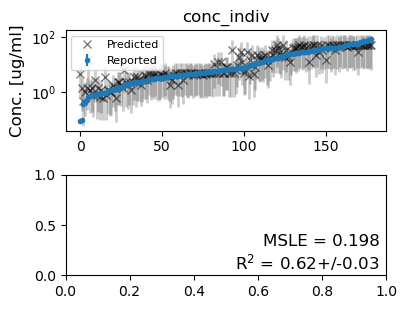

In [37]:
pfas_male_1cmpt_mouse.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [38]:
pfas_male_2cmpt_mouse = PyPKMC(pfas_male_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior, #pop_SD_prior=0.2
                              )
pfas_male_2cmpt_mouse.sample(model_type='2-compartment', target_accept=0.999, nuts_sampler='numpyro', #hierarchy='single',
                             load_trace=load_trace, tune=12000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFOA_Male_mouse_2cmpt
single level model, 2-compartment


Sampling: [conc_indiv, conc_summary, lnCLC, lnR, lnVdss, lnk_abs, lnk_cd, sigma]


  0%|          | 0/17000 [00:00<?, ?it/s]

  0%|          | 0/17000 [00:00<?, ?it/s]

  0%|          | 0/17000 [00:00<?, ?it/s]

  0%|          | 0/17000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (26), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


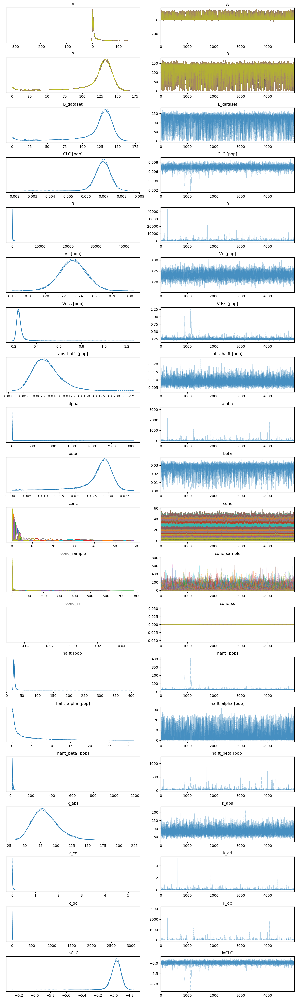

In [39]:
with pfas_male_2cmpt_mouse.model:
    az.plot_trace(pfas_male_2cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


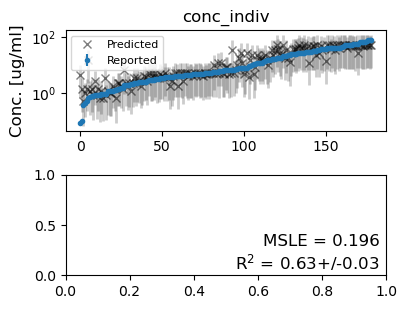

In [40]:
pfas_male_2cmpt_mouse.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-526.186071,9.217386,0.00000,1.0,27.681928,0.000000,True,log
1_compartment,1,-526.461281,8.748908,0.27521,0.0,27.471518,0.441293,True,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

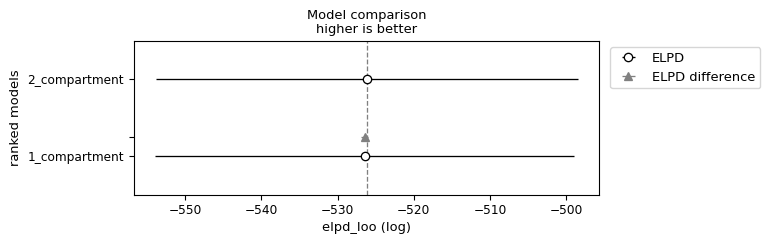

In [41]:
pfas_male_mouse_compare = az.compare({"1_compartment": pfas_male_1cmpt_mouse._trace, "2_compartment": pfas_male_2cmpt_mouse._trace},
                           var_name="combined",ic='loo')
display(pfas_male_mouse_compare)
az.plot_compare(pfas_male_mouse_compare, insample_dev=False)

#### Define winning model

In [104]:
pfas_male_mouse = pfas_male_2cmpt_mouse
print(pfas_male_mouse.N_divergences)
print(f'Pass all metrics = {pfas_male_mouse.pass_all_metrics}')

0
Pass all metrics = True


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


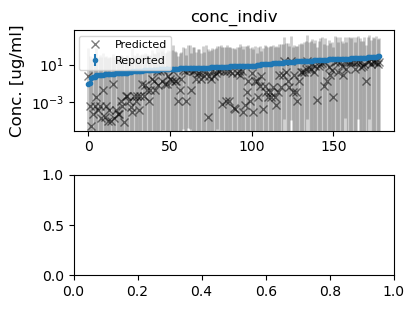

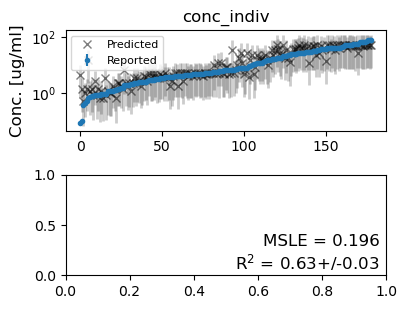

In [43]:
pfas_male_mouse.plot_data_ppc(group='prior', savefig=True)
pfas_male_mouse.plot_data_ppc(group='posterior', savefig=True)

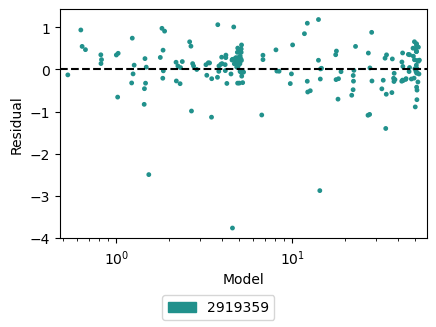

In [44]:
pfas_male_mouse.plot_residuals() 

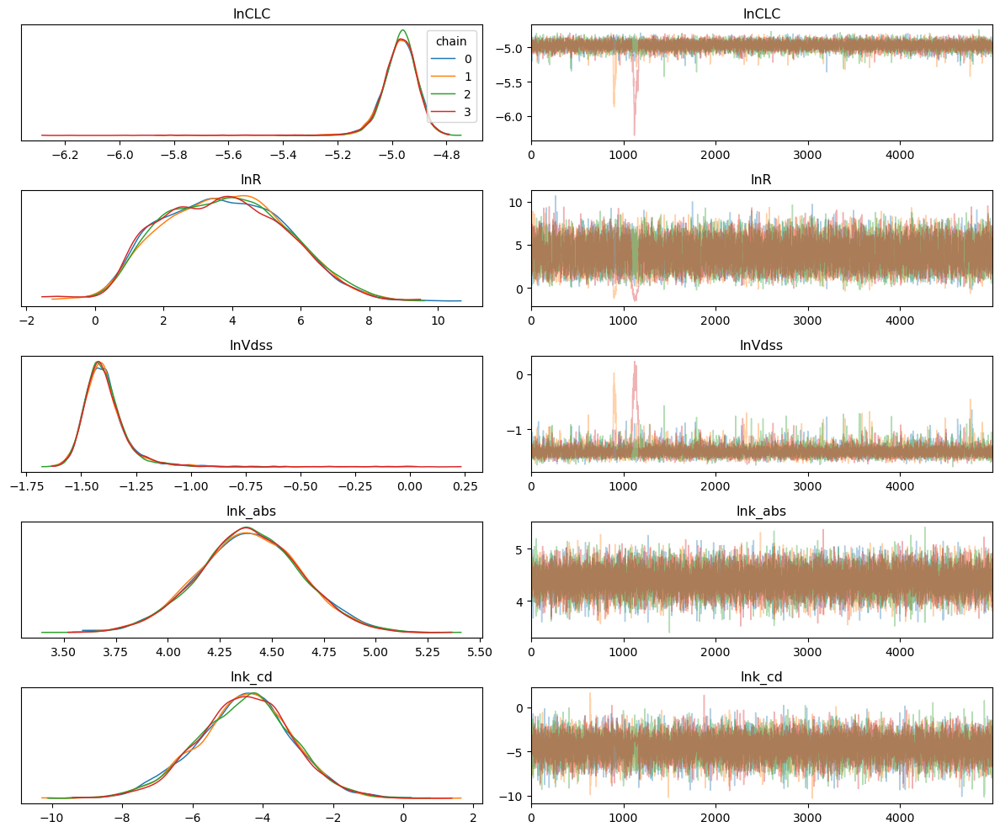

In [45]:
trace_model = pfas_male_mouse
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/mouse/PFOA/PFOA_Male_mouse_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


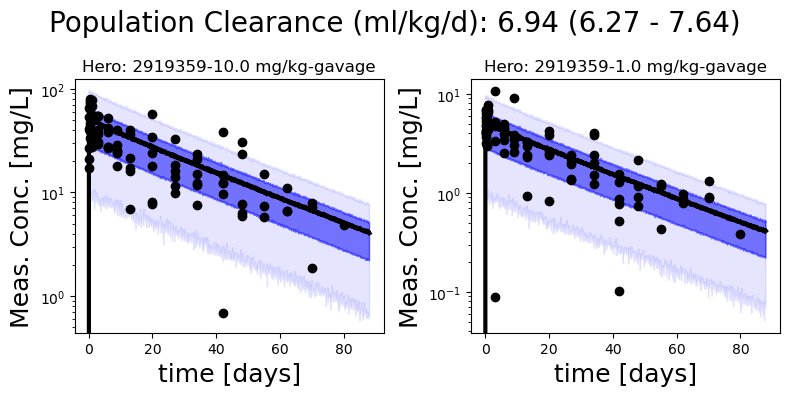

In [46]:
pfas_male_mouse.plot_all_studies()

### PK stats

In [47]:
pfas_male_mouse.get_pk_stats()

,mean,sd,hdi_5%,hdi_95%
CLC [pop],0.00694,0.00048,0.00627,0.00764
Vc [pop],0.23286,0.01594,0.20770,0.25985
Vdss [pop],0.25216,0.04549,0.21229,0.28448
abs_halft [pop],0.00883,0.00221,0.00526,0.01222
halft [pop],25.63050,10.60496,20.64031,29.09175
halft_alpha [pop],4.20149,5.54488,0.00023,12.41622
halft_beta [pop],28.85716,24.40462,19.96392,33.39016


## Female

In [48]:
%%time
pfas_female_data_mouse = pfas_tmp.get_processed_data(chemical=chemical, sex='Female', species='mouse')
pfas_female_data_mouse.head()

Hero ID available:  [2919359 2990271 3749227 3749289 3858670 3859701 5916078 6302380]
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No BW info for mouse in 2919359, using defaults
No

,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,2919359,56,3252,1,-1.0,NaN,0.029,NaN,mouse,CD-1,1.0,mg/kg,4.0,hour,5670.0,0.0,0,ng/ml,gavage,serum,Female,DTXSID8031865,Supplementary Table 1 mg/kg Block 1,75.0,days,NaN,Not Reported,3,Lou,Perfluorooctanoic acid,PFOA,335-67-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-pentadecafluoroo...",DTXSID8031865,17,0,0,0,0.166667,1.0,0.029,5.67,0.0,0.0,-1,0,1,1,0.0,1.735189,0.0,True,0.029,2919359-1.0 mg/kg-gavage
1,2919359,56,3253,1,-1.0,NaN,0.029,NaN,mouse,CD-1,1.0,mg/kg,4.0,hour,5230.0,0.0,0,ng/ml,gavage,serum,Female,DTXSID8031865,Supplementary Table 1 mg/kg Block 1,75.0,days,NaN,Not Reported,3,Lou,Perfluorooctanoic acid,PFOA,335-67-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-pentadecafluoroo...",DTXSID8031865,17,0,0,0,0.166667,1.0,0.029,5.23,0.0,0.0,-1,0,1,1,0.0,1.654411,0.0,True,0.029,2919359-1.0 mg/kg-gavage
2,2919359,56,3254,1,-1.0,NaN,0.029,NaN,mouse,CD-1,1.0,mg/kg,4.0,hour,4910.0,0.0,0,ng/ml,gavage,serum,Female,DTXSID8031865,Supplementary Table 1 mg/kg Block 1,75.0,days,NaN,Not Reported,3,Lou,Perfluorooctanoic acid,PFOA,335-67-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-pentadecafluoroo...",DTXSID8031865,17,0,0,0,0.166667,1.0,0.029,4.91,0.0,0.0,-1,0,1,1,0.0,1.591274,0.0,True,0.029,2919359-1.0 mg/kg-gavage
3,2919359,56,3757,1,-1.0,NaN,0.029,NaN,mouse,CD-1,1.0,mg/kg,4.0,hour,5930.0,0.0,0,ng/ml,gavage,serum,Female,DTXSID8031865,Supplementary Table 1 mg/kg Block 2,75.0,days,NaN,Not Reported,3,Lou,Perfluorooctanoic acid,PFOA,335-67-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-pentadecafluoroo...",DTXSID8031865,17,0,0,0,0.166667,1.0,0.029,5.93,0.0,0.0,-1,0,1,1,0.0,1.780024,0.0,True,0.029,2919359-1.0 mg/kg-gavage
4,2919359,56,3758,1,-1.0,NaN,0.029,NaN,mouse,CD-1,1.0,mg/kg,4.0,hour,5800.0,0.0,0,ng/ml,gavage,serum,Female,DTXSID8031865,Supplementary Table 1 mg/kg Block 2,75.0,days,NaN,Not Reported,3,Lou,Perfluorooctanoic acid,PFOA,335-67-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-pentadecafluoroo...",DTXSID8031865,17,0,0,0,0.166667,1.0,0.029,5.80,0.0,0.0,-1,0,1,1,0.0,1.757858,0.0,True,0.029,2919359-1.0 mg/kg-gavage


### Run the models

#### 1-Compartment model

In [49]:
pfas_female_1cmpt_mouse = PyPKMC(pfas_female_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_1cmpt_mouse.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFOA_Female_mouse_1cmpt
hierarchical model, 1-compartment


Sampling: [conc_indiv, conc_summary, lnCLC_offset, lnVd_offset, lnk_abs_offset, mu_lnCLC, mu_lnVd, mu_lnk_abs, sigma, sigma_lnCLC, sigma_lnVd, sigma_lnk_abs]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (39), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


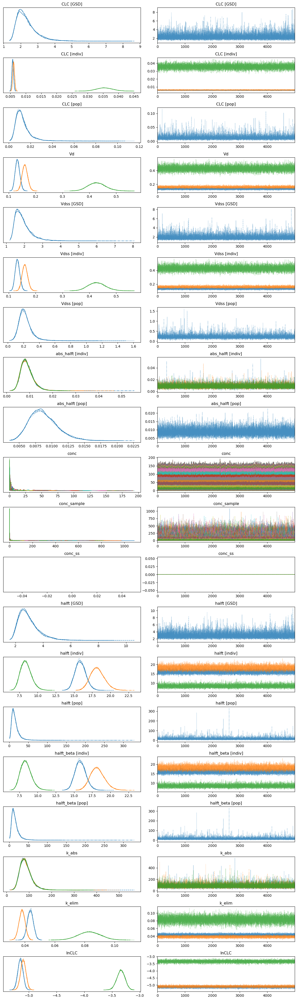

In [50]:
with pfas_female_1cmpt_mouse.model:
    az.plot_trace(pfas_female_1cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


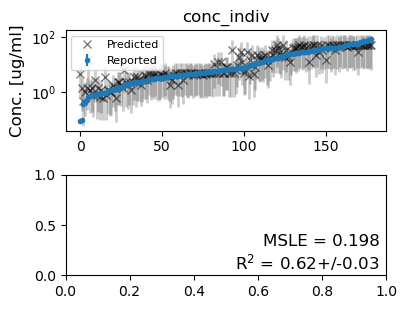

In [51]:
pfas_male_1cmpt_mouse.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [52]:
pfas_female_2cmpt_mouse = PyPKMC(pfas_female_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_2cmpt_mouse.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFOA_Female_mouse_2cmpt
hierarchical model, 2-compartment


Sampling: [conc_indiv, conc_summary, lnCLC_offset, lnR_offset, lnVdss_offset, lnk_abs_offset, lnk_cd_offset, mu_lnCLC, mu_lnR, mu_lnVdss, mu_lnk_abs, mu_lnk_cd, sigma, sigma_lnCLC, sigma_lnR, sigma_lnVdss, sigma_lnk_abs, sigma_lnk_cd]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (77), generating only 20 plots
  warnings.warn(


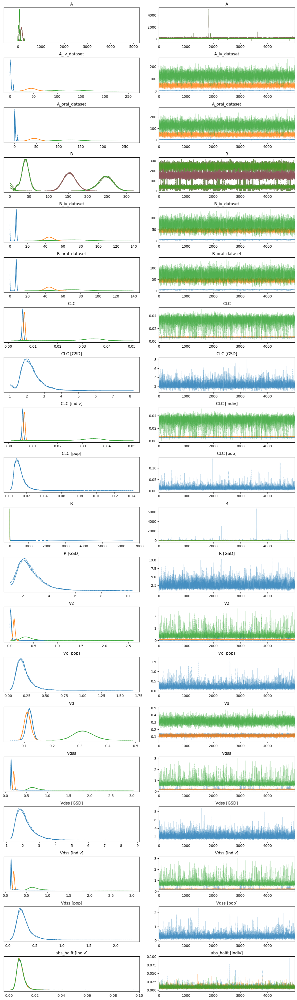

In [53]:
with pfas_female_2cmpt_mouse.model:
    az.plot_trace(pfas_female_2cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


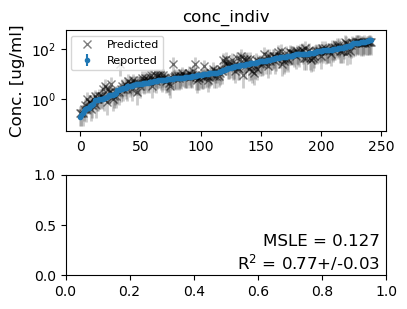

In [54]:
pfas_female_2cmpt_mouse.plot_data_ppc(group='posterior')

#### Compare models

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-791.786163,11.795183,0.000000,1.000000e+00,31.436537,0.000000,False,log
1_compartment,1,-814.309007,8.308235,22.522844,3.051781e-12,31.957380,5.511494,False,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

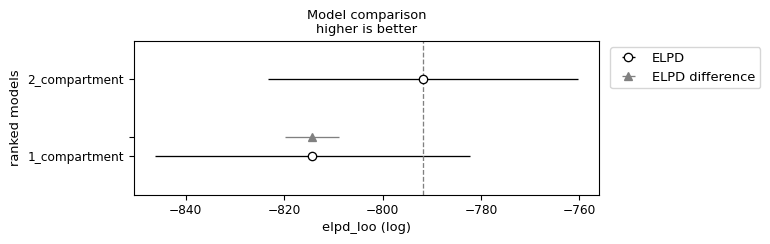

In [55]:
pfas_female_mouse_compare = az.compare({"1_compartment": pfas_female_1cmpt_mouse._trace, "2_compartment": pfas_female_2cmpt_mouse._trace},
                           var_name="combined",ic='loo')
display(pfas_female_mouse_compare)
az.plot_compare(pfas_female_mouse_compare, insample_dev=False)

#### Define winning model

In [105]:
pfas_female_mouse = pfas_female_2cmpt_mouse
print(pfas_female_mouse.N_divergences)
print(f'Pass all metrics = {pfas_female_mouse.pass_all_metrics}')

0
Pass all metrics = True


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


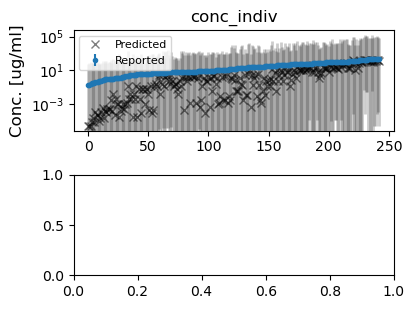

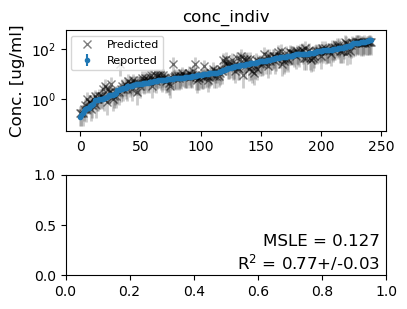

In [57]:
pfas_female_mouse.plot_data_ppc(group='prior', savefig=True)
pfas_female_mouse.plot_data_ppc(group='posterior', savefig=True)

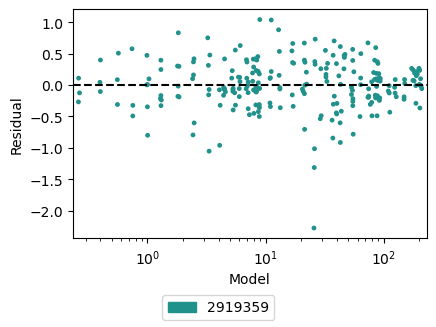

In [58]:
pfas_female_mouse.plot_residuals() 

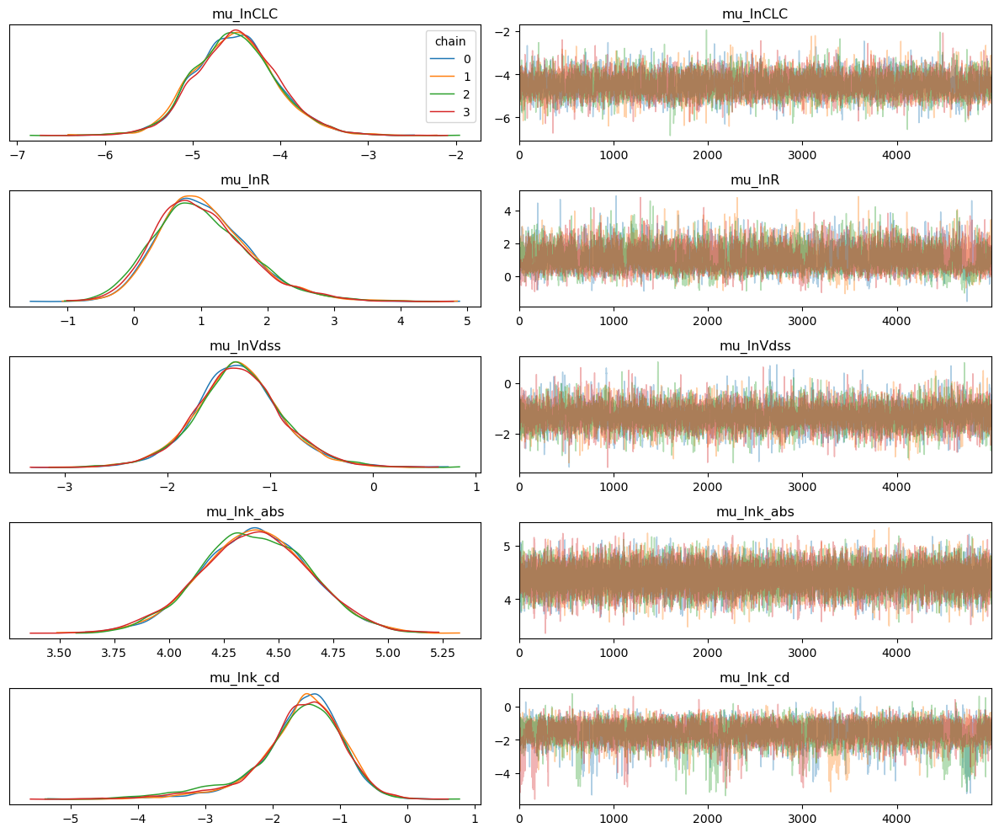

In [59]:
trace_model = pfas_female_mouse
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/mouse/PFOA/PFOA_Female_mouse_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


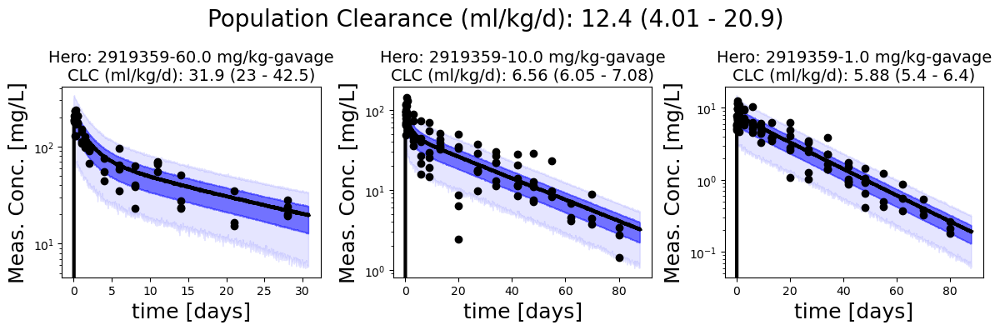

In [60]:
pfas_female_mouse.plot_all_studies()

### PK stats

In [61]:
pfas_female_mouse.get_pk_stats()

,mean,sd,hdi_5%,hdi_95%
CLC [pop],0.01238,0.00694,0.00401,0.02092
Vc [pop],0.21315,0.11167,0.06809,0.35339
Vdss [pop],0.29850,0.14978,0.10025,0.48495
abs_halft [pop],0.00883,0.00223,0.00537,0.01230
halft [pop],21.45258,17.49832,3.07920,40.44837
halft_alpha [pop],1.15063,1.34497,0.05945,2.11126
halft_beta [pop],22.74766,18.35856,3.05513,42.48928


# Primate

## Male

In [62]:
%%time
pfas_male_data_primate = pfas_tmp.get_processed_data(chemical=chemical, sex='Male', species='primate')
pfas_male_data_primate.head()

Hero ID available:  [2919359 2990271 3749227 3749289 3858670 3859701 5916078 6302380]
dropping duplicated column
Hero ID used:  [3749227]
CPU times: user 106 ms, sys: 5.8 ms, total: 112 ms
Wall time: 111 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,3749227,51,2052,1,-1.0,NaN,5.0,NaN,primate,cynomolgus,10.0,mg/kg,0.5,hour,91.13,0.0,0,ug/ml,iv,serum,Male,DTXSID8031865,Table 5,2.75,years,5.0,kilograms,1,Butenhoff,Perfluorooctanoic acid,PFOA,335-67-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-pentadecafluoroo...",DTXSID8031865,15,0,0,0,0.020833,10.0,5.0,91.13,0.0,0.0,-1,0,0,0,0.0,4.512287,0.0,True,50.0,3749227-10.0 mg/kg-iv
1,3749227,51,2054,1,-1.0,NaN,5.0,NaN,primate,cynomolgus,10.0,mg/kg,0.5,hour,96.66,0.0,0,ug/ml,iv,serum,Male,DTXSID8031865,Table 5,2.75,years,5.0,kilograms,1,Butenhoff,Perfluorooctanoic acid,PFOA,335-67-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-pentadecafluoroo...",DTXSID8031865,15,0,0,0,0.020833,10.0,5.0,96.66,0.0,0.0,-1,0,0,0,0.0,4.571200,0.0,True,50.0,3749227-10.0 mg/kg-iv
2,3749227,51,2211,1,-1.0,NaN,5.0,NaN,primate,cynomolgus,10.0,mg/kg,0.5,hour,91.37,0.0,0,ug/ml,iv,serum,Male,DTXSID8031865,Table 5,2.75,years,5.0,kilograms,1,Butenhoff,Perfluorooctanoic acid,PFOA,335-67-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-pentadecafluoroo...",DTXSID8031865,15,0,0,0,0.020833,10.0,5.0,91.37,0.0,0.0,-1,0,0,0,0.0,4.514917,0.0,True,50.0,3749227-10.0 mg/kg-iv
3,3749227,51,2052,1,-1.0,NaN,5.0,NaN,primate,cynomolgus,10.0,mg/kg,2.0,hour,67.90,0.0,0,ug/ml,iv,serum,Male,DTXSID8031865,Table 5,2.75,years,5.0,kilograms,1,Butenhoff,Perfluorooctanoic acid,PFOA,335-67-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-pentadecafluoroo...",DTXSID8031865,15,0,0,0,0.083333,10.0,5.0,67.90,0.0,0.0,-1,0,0,0,0.0,4.218036,0.0,True,50.0,3749227-10.0 mg/kg-iv
4,3749227,51,2054,1,-1.0,NaN,5.0,NaN,primate,cynomolgus,10.0,mg/kg,2.0,hour,91.63,0.0,0,ug/ml,iv,serum,Male,DTXSID8031865,Table 5,2.75,years,5.0,kilograms,1,Butenhoff,Perfluorooctanoic acid,PFOA,335-67-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-pentadecafluoroo...",DTXSID8031865,15,0,0,0,0.083333,10.0,5.0,91.63,0.0,0.0,-1,0,0,0,0.0,4.517759,0.0,True,50.0,3749227-10.0 mg/kg-iv


### Run the models

#### 1-Compartment model

In [63]:
pfas_male_1cmpt_primate = PyPKMC(pfas_male_data_primate, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_1cmpt_primate.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFOA_Male_primate_1cmpt
single level model, 1-compartment


Sampling: [conc_indiv, conc_summary, lnCLC, lnVd, lnk_abs, sigma]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


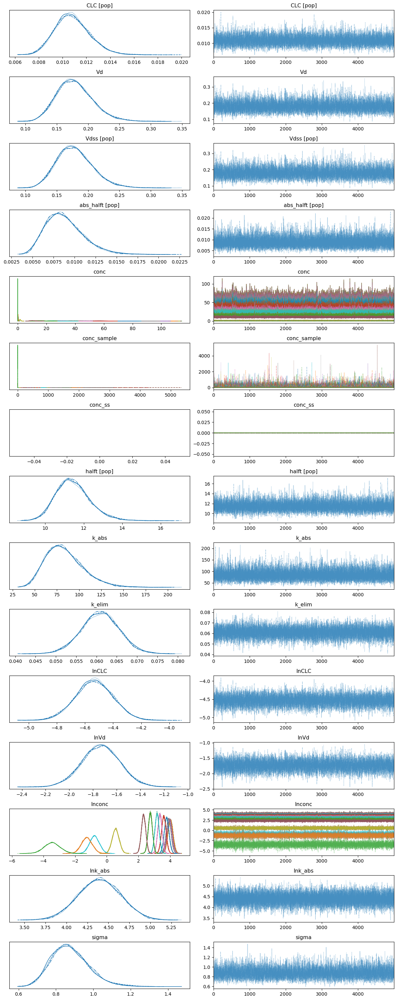

In [64]:
with pfas_male_1cmpt_primate.model:
    az.plot_trace(pfas_male_1cmpt_primate._trace)
    plt.tight_layout()

conc_indiv
conc_summary


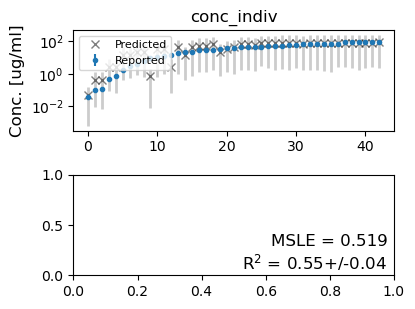

In [65]:
pfas_male_1cmpt_primate.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [66]:
pfas_male_2cmpt_primate = PyPKMC(pfas_male_data_primate, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_2cmpt_primate.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFOA_Male_primate_2cmpt
single level model, 2-compartment


Sampling: [conc_indiv, conc_summary, lnCLC, lnR, lnVdss, lnk_abs, lnk_cd, sigma]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (26), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


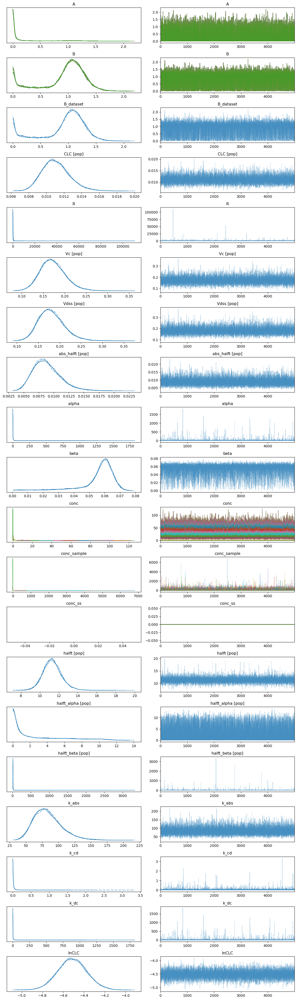

In [67]:
with pfas_male_2cmpt_primate.model:
    az.plot_trace(pfas_male_2cmpt_primate._trace)
    plt.tight_layout()

conc_indiv
conc_summary


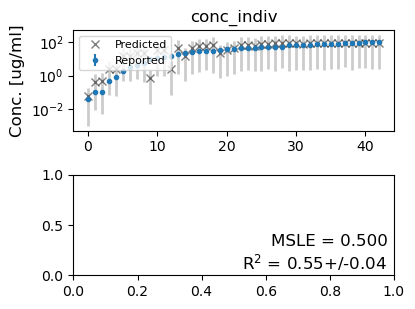

In [68]:
pfas_male_2cmpt_primate.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
1_compartment,0,-182.949794,6.017570,0.000000,1.000000e+00,13.938768,0.0000,True,log
2_compartment,1,-183.316658,6.950401,0.366864,1.110223e-16,14.296243,0.6853,True,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

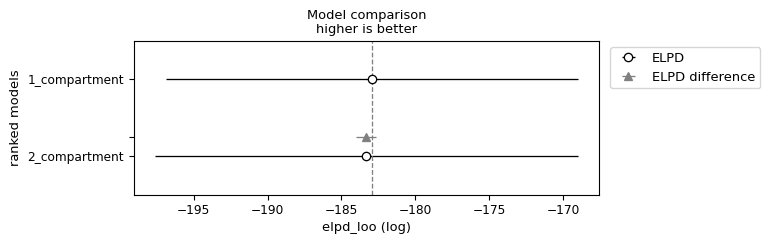

In [69]:
pfas_male_primate_compare = az.compare({"1_compartment": pfas_male_1cmpt_primate._trace, "2_compartment": pfas_male_2cmpt_primate._trace},
                           var_name="combined",ic='loo')
display(pfas_male_primate_compare)
az.plot_compare(pfas_male_primate_compare, insample_dev=False)

#### Define winning model

In [109]:
pfas_male_primate = pfas_male_1cmpt_primate
print(pfas_male_primate.N_divergences)
print(f'Pass all metrics = {pfas_male_2cmpt_primate.pass_all_metrics}')

0
Pass all metrics = True


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


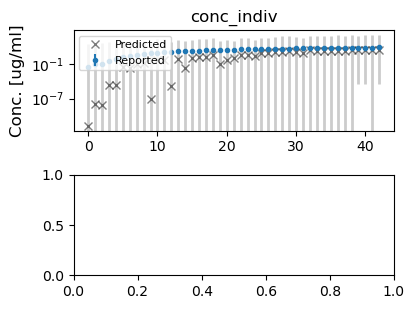

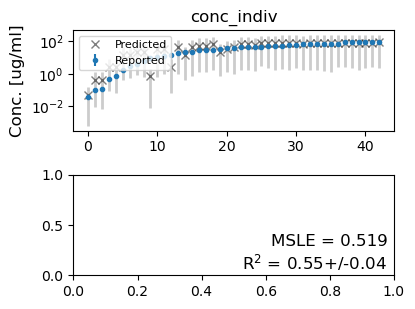

In [110]:
pfas_male_primate.plot_data_ppc(group='prior', savefig=True)
pfas_male_primate.plot_data_ppc(group='posterior', savefig=True)

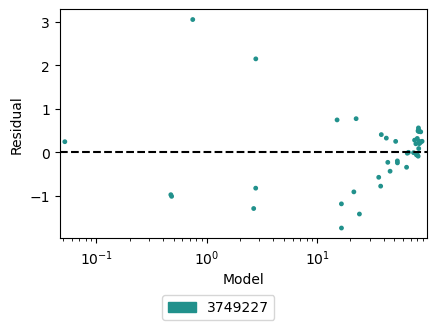

In [111]:
pfas_male_primate.plot_residuals() 

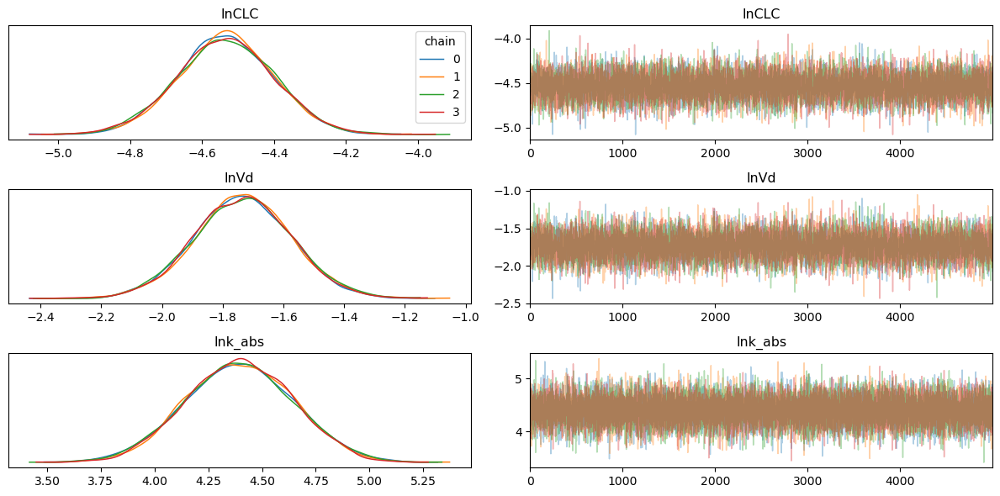

In [112]:
trace_model = pfas_male_primate
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

Sampling: [conc_sample]


Output()

../species_fits/primate/PFOA/PFOA_Male_primate_CLC_1cmpt.pdf
Running PPC...
setting params...
sampling...


Calculating stats...


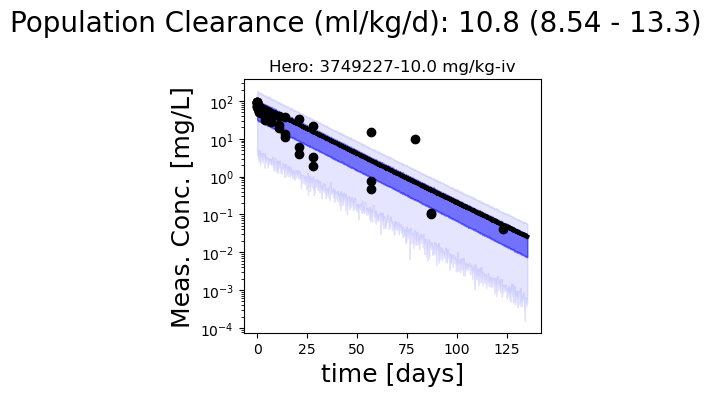

In [113]:
pfas_male_primate.plot_all_studies()

### PK stats

In [114]:
pfas_male_primate.get_pk_stats()

,mean,sd,hdi_5%,hdi_95%
CLC [pop],0.01083,0.00146,0.00854,0.01326
Vdss [pop],0.17901,0.02904,0.13047,0.22374
abs_halft [pop],0.00883,0.00225,0.00523,0.01223
halft [pop],11.44871,0.89996,9.99535,12.87838


## Female

In [76]:
%%time
pfas_female_data_primate = pfas_tmp.get_processed_data(chemical=chemical, sex='Female', species='primate')
pfas_female_data_primate.head()

Hero ID available:  [2919359 2990271 3749227 3749289 3858670 3859701 5916078 6302380]
dropping duplicated column
Hero ID used:  [3749227]
CPU times: user 107 ms, sys: 1.06 ms, total: 108 ms
Wall time: 107 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,3749227,52,2058,1,-1.0,NaN,4.0,NaN,primate,cynomolgus,10.0,mg/kg,0.5,hour,96.40,0.0,0,ug/ml,iv,serum,Female,DTXSID8031865,Table 5,2.75,years,4.0,kilograms,1,Butenhoff,Perfluorooctanoic acid,PFOA,335-67-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-pentadecafluoroo...",DTXSID8031865,14,0,0,0,0.020833,10.0,4.0,96.40,0.0,0.0,-1,0,0,1,0.0,4.568506,0.0,True,40.0,3749227-10.0 mg/kg-iv
1,3749227,52,2059,1,-1.0,NaN,4.0,NaN,primate,cynomolgus,10.0,mg/kg,0.5,hour,88.94,0.0,0,ug/ml,iv,serum,Female,DTXSID8031865,Table 5,2.75,years,4.0,kilograms,1,Butenhoff,Perfluorooctanoic acid,PFOA,335-67-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-pentadecafluoroo...",DTXSID8031865,14,0,0,0,0.020833,10.0,4.0,88.94,0.0,0.0,-1,0,0,1,0.0,4.487962,0.0,True,40.0,3749227-10.0 mg/kg-iv
2,3749227,52,2061,1,-1.0,NaN,4.0,NaN,primate,cynomolgus,10.0,mg/kg,0.5,hour,94.08,0.0,0,ug/ml,iv,serum,Female,DTXSID8031865,Table 5,2.75,years,4.0,kilograms,1,Butenhoff,Perfluorooctanoic acid,PFOA,335-67-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-pentadecafluoroo...",DTXSID8031865,14,0,0,0,0.020833,10.0,4.0,94.08,0.0,0.0,-1,0,0,1,0.0,4.544145,0.0,True,40.0,3749227-10.0 mg/kg-iv
3,3749227,52,2058,1,-1.0,NaN,4.0,NaN,primate,cynomolgus,10.0,mg/kg,2.0,hour,74.28,0.0,0,ug/ml,iv,serum,Female,DTXSID8031865,Table 5,2.75,years,4.0,kilograms,1,Butenhoff,Perfluorooctanoic acid,PFOA,335-67-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-pentadecafluoroo...",DTXSID8031865,14,0,0,0,0.083333,10.0,4.0,74.28,0.0,0.0,-1,0,0,1,0.0,4.307842,0.0,True,40.0,3749227-10.0 mg/kg-iv
4,3749227,52,2059,1,-1.0,NaN,4.0,NaN,primate,cynomolgus,10.0,mg/kg,2.0,hour,77.87,0.0,0,ug/ml,iv,serum,Female,DTXSID8031865,Table 5,2.75,years,4.0,kilograms,1,Butenhoff,Perfluorooctanoic acid,PFOA,335-67-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-pentadecafluoroo...",DTXSID8031865,14,0,0,0,0.083333,10.0,4.0,77.87,0.0,0.0,-1,0,0,1,0.0,4.355041,0.0,True,40.0,3749227-10.0 mg/kg-iv


### Run the models

#### 1-Compartment model

In [77]:
pfas_female_1cmpt_primate = PyPKMC(pfas_female_data_primate, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_1cmpt_primate.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFOA_Female_primate_1cmpt
single level model, 1-compartment


Sampling: [conc_indiv, conc_summary, lnCLC, lnVd, lnk_abs, sigma]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


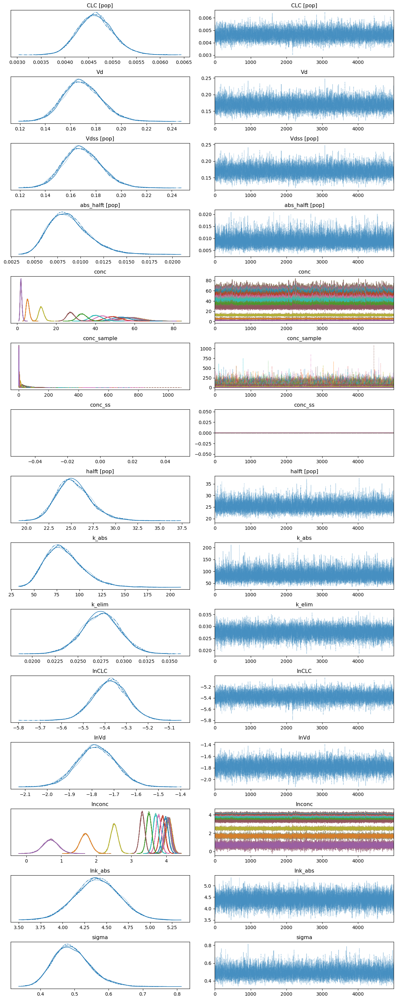

In [78]:
with pfas_female_1cmpt_primate.model:
    az.plot_trace(pfas_female_1cmpt_primate._trace)
    plt.tight_layout()

conc_indiv
conc_summary


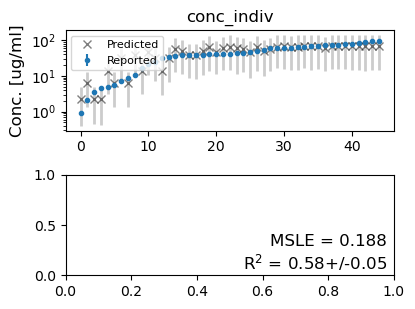

In [79]:
pfas_female_1cmpt_primate.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [80]:
pfas_female_2cmpt_primate = PyPKMC(pfas_female_data_primate, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_2cmpt_primate.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFOA_Female_primate_2cmpt
single level model, 2-compartment


Sampling: [conc_indiv, conc_summary, lnCLC, lnR, lnVdss, lnk_abs, lnk_cd, sigma]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

There were 1 divergences after tuning. Increase `target_accept` or reparameterize.
Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...
Checking metrics...
Pass all metrics = False
Assign pareto...


/data/tzurlind/Desktop/PKWG/manuscript_code/animal_pfas_manuscript/pfas_notebooks/../PyPKMC.py:1025: UserWarning: There were 1 divergences after tuning. Increase `target_accept` or reparameterize.
  warnings.warn(msg)


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (26), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


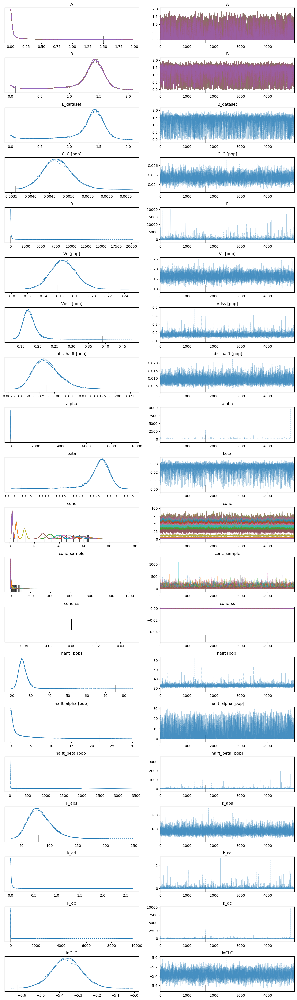

In [81]:
with pfas_female_2cmpt_primate.model:
    az.plot_trace(pfas_female_2cmpt_primate._trace)
    plt.tight_layout()

conc_indiv
conc_summary


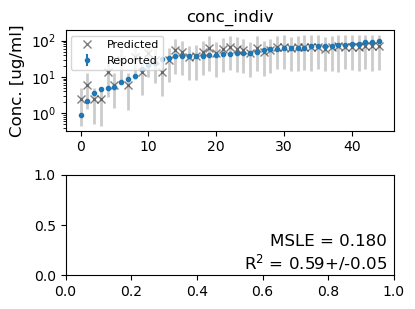

In [82]:
pfas_female_2cmpt_primate.plot_data_ppc(group='posterior')

#### Compare models

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-188.087338,4.806147,0.000000,1.0,5.594066,0.000000,False,log
1_compartment,1,-188.501329,4.457636,0.413991,0.0,5.697631,0.453025,False,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

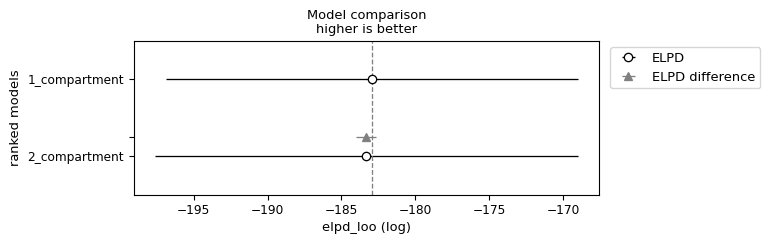

In [83]:
pfas_female_primate_compare = az.compare({"1_compartment": pfas_female_1cmpt_primate._trace, "2_compartment": pfas_female_2cmpt_primate._trace},
                           var_name="combined",ic='loo')
display(pfas_female_primate_compare)
az.plot_compare(pfas_male_primate_compare, insample_dev=False)

#### Define winning model

In [115]:
pfas_female_primate = pfas_female_1cmpt_primate
print(pfas_female_primate.N_divergences)
print(f'Pass all metrics = {pfas_female_primate.pass_all_metrics}')

0
Pass all metrics = True


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


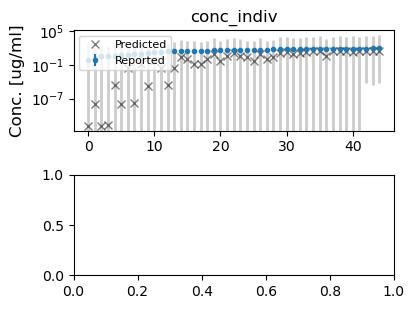

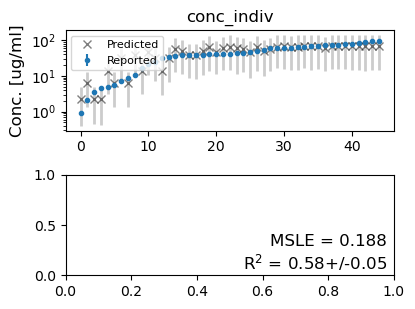

In [116]:
pfas_female_primate.plot_data_ppc(group='prior', savefig=True)
pfas_female_primate.plot_data_ppc(group='posterior', savefig=True)

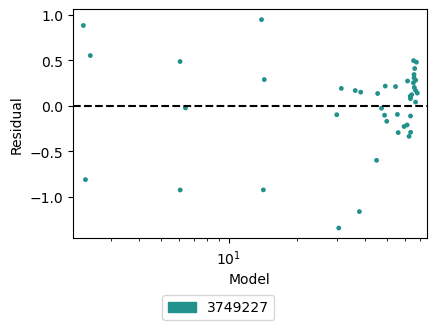

In [117]:
pfas_female_primate.plot_residuals() 

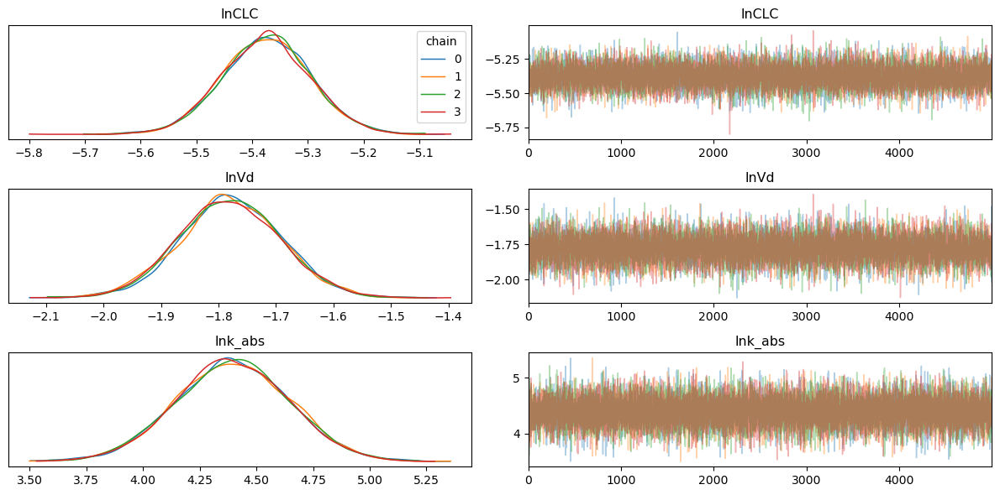

In [118]:
trace_model = pfas_female_primate
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

Sampling: [conc_sample]


Output()

../species_fits/primate/PFOA/PFOA_Female_primate_CLC_1cmpt.pdf
Running PPC...
setting params...
sampling...


Calculating stats...


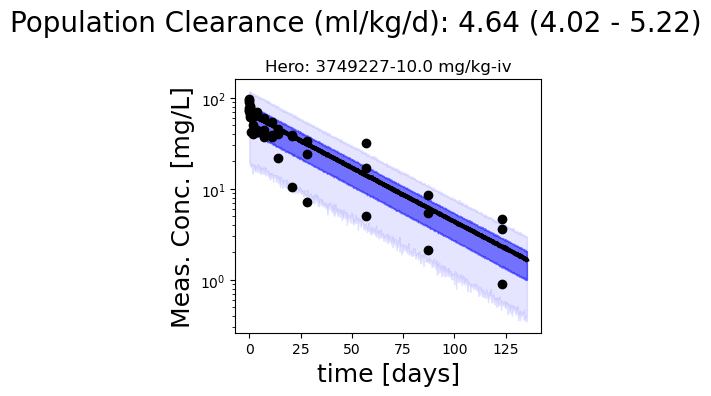

In [119]:
pfas_female_primate.plot_all_studies()

### PK stats

In [120]:
pfas_female_primate.get_pk_stats()

,mean,sd,hdi_5%,hdi_95%
CLC [pop],0.00464,0.00037,0.00402,0.00522
Vdss [pop],0.16943,0.01498,0.14449,0.19323
abs_halft [pop],0.00883,0.00224,0.00513,0.01212
halft [pop],25.34252,1.96352,22.24019,28.52321
